# i3sense 2D CLT panel Model validation 0.9 x 0.9 x 0.1

In [54]:
import pandas as pd
import seaborn as sns
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import logging
import scipy.stats as stats
import re
from matplotlib import colormaps
from mpl_toolkits.mplot3d import Axes3D  # noqa: F401
from scipy.signal import savgol_filter

In [55]:
df = pd.read_excel("resume_2D_richard.xlsx", sheet_name = None)
df_o = df.copy()
# check sheet names
for sheet_name, names in df.items():
    print(f"Sheet name: {sheet_name}")
    print(names.head())  # or print(df) if you want the full table
    print("-" * 40)

Sheet name: resume
   Unnamed: 0          Unnamed: 1           Unnamed: 2  Unnamed: 3  \
0         NaN                 NaT                  NaN         NaN   
1         NaN                 NaT                  NaN         NaN   
2         NaN 2025-10-01 07:46:30   test s 1kg závažím         NaN   
3         NaN 2025-10-01 07:47:30    začiatok vlhnutia         NaN   
4         NaN 2025-11-04 18:00:00  začiatok vysychania         NaN   

   Unnamed: 4  Unnamed: 5  Unnamed: 6  Unnamed: 7  Unnamed: 8 Unnamed: 9  ...  \
0         NaN         NaN         NaN         NaN         NaN        NaN  ...   
1         NaN         NaN         NaN         NaN         NaN        NaN  ...   
2         NaN         NaN         NaN         NaN         NaN        NaN  ...   
3         NaN         NaN         NaN         NaN         NaN   1 vrstva  ...   
4         NaN         NaN         NaN         NaN         NaN        NaN  ...   

   Unnamed: 11  Unnamed: 12  Unnamed: 13  Unnamed: 14  Unnamed: 15  \
0  

## From RH to Moisture content - EMC

### GET temp for temperature

In [40]:
# get table of temperatures and set time to seconds
temp = df["t"].copy()

# Subtract datetime separately
datetime_col = "cas"
temp[datetime_col] = temp[datetime_col] - temp.iloc[0][datetime_col]
## Date to minutes and seconds
temp[datetime_col] = temp[datetime_col].dt.total_seconds()
# Rename 'cas' to 'time'
temp = temp.rename(columns={datetime_col: "time"})
temp

,time,t1,t2,t3,t4,t5,t6,t7,t8,t9,...,t40,t41,t42,t43,t44,t45,t46,t47,t48,t49
0,0.0,17.68,17.66,17.63,17.66,17.68,17.73,17.82,17.94,17.90,...,17.77,17.79,17.78,17.89,17.82,17.67,17.91,17.85,18.49,18.43
1,300.0,17.67,17.66,17.62,17.66,17.68,17.73,17.81,17.94,17.90,...,17.77,17.79,17.77,17.89,17.82,17.67,17.91,17.84,18.49,18.41
2,600.0,17.66,17.65,17.61,17.66,17.68,17.72,17.81,17.93,17.89,...,17.77,17.78,17.78,17.88,17.82,17.66,17.91,17.84,18.48,18.41
3,901.0,17.66,17.64,17.61,17.65,17.68,17.72,17.81,17.93,17.89,...,17.76,17.78,17.77,17.89,17.82,17.66,17.90,17.84,18.48,18.39
4,1201.0,17.66,17.64,17.61,17.65,17.67,17.72,17.81,17.93,17.88,...,17.76,17.77,17.77,17.88,17.81,17.65,17.90,17.84,18.48,18.37
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9530,3082075.0,23.15,23.03,23.29,23.76,23.89,23.87,24.00,24.16,24.38,...,23.16,23.66,23.46,23.54,23.53,23.83,23.86,23.82,24.49,26.47
9531,3082375.0,23.15,23.03,23.28,23.76,23.89,23.87,24.00,24.16,24.36,...,23.18,23.67,23.47,23.56,23.54,23.84,23.88,23.84,24.50,26.42
9532,3082675.0,23.15,23.02,23.28,23.75,23.89,23.86,23.99,24.16,24.35,...,23.20,23.68,23.49,23.57,23.57,23.86,23.89,23.85,24.53,26.39
9533,3082975.0,23.14,23.02,23.27,23.75,23.88,23.86,23.98,24.16,24.35,...,23.23,23.68,23.50,23.58,23.58,23.87,23.90,23.86,24.54,26.33


### get rh for moisture - no modification needed, r49 is reference sensor

In [44]:
# get table of temperatures and set time to seconds
rh = df["rh"].copy()

# Subtract datetime separately
datetime_col = "cas"
rh[datetime_col] = rh[datetime_col] - rh.iloc[0][datetime_col]
## Date to minutes and seconds
rh[datetime_col] = rh[datetime_col].dt.total_seconds()
# Rename 'cas' to 'time'
rh = rh.rename(columns={datetime_col: "time"})
rh

,time,r1,r2,r3,r4,r5,r6,r7,r8,r9,...,r40,r41,r42,r43,r44,r45,r46,r47,r48,r49
0,0.0,51.41,50.38,49.32,50.23,51.98,50.34,51.76,50.34,52.88,...,50.18,50.55,50.66,49.93,50.50,49.50,50.71,49.98,50.95,42.01
1,300.0,51.41,50.38,49.32,50.23,51.95,50.34,51.76,50.34,52.88,...,50.18,50.52,50.66,49.93,50.50,49.50,50.71,49.98,50.95,42.06
2,600.0,51.41,50.38,49.32,50.23,51.95,50.34,51.76,50.34,52.82,...,50.18,50.52,50.66,49.93,50.50,49.50,50.71,49.98,50.95,41.99
3,901.0,51.41,50.38,49.32,50.23,51.95,50.34,51.76,50.34,52.82,...,50.16,50.52,50.66,49.93,50.50,49.46,50.71,49.98,50.95,42.06
4,1201.0,51.41,50.38,49.32,50.23,51.95,50.34,51.76,50.34,52.82,...,50.16,50.52,50.66,49.93,50.50,49.46,50.69,49.98,50.95,42.09
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9530,3082075.0,66.62,66.44,49.19,45.96,50.20,49.92,50.08,45.37,49.02,...,56.97,47.79,51.56,52.85,52.92,45.04,49.25,50.85,52.11,30.35
9531,3082375.0,66.62,66.47,49.23,45.96,50.22,49.92,50.08,45.37,49.02,...,56.97,47.79,51.58,52.85,52.92,45.07,49.25,50.92,52.11,30.45
9532,3082675.0,66.64,66.50,49.26,45.99,50.23,49.95,50.11,45.40,49.02,...,57.00,47.79,51.61,52.85,52.92,45.10,49.28,50.92,52.11,30.48
9533,3082975.0,66.64,66.50,49.29,45.99,50.23,49.95,50.11,45.40,49.02,...,57.00,47.79,51.61,52.88,52.95,45.13,49.28,50.92,52.11,30.57


In [43]:
#rh.plot (x="time")

### compute w from RH - never will go over FSP

In [69]:
## Values A and B for calculatin of W
# Value A eq. 4.38a, Horacek 1998 constants are given
cn_temp_all = [f't{i}' for i in range(1, 50)]
A = 7.731706 - 0.014348 * (temp[cn_temp_all]+273.5)
# Value B eq. 4.38a, Horacek 1998 constants are given
B = 0.008746 + 0.000567 * (temp[cn_temp_all]+273.5)

# Create an empty DataFrame
w = pd.DataFrame(index=A.index)

# If there's a one-to-one correspondence between temperature and humidity columns
# (e.g., t1 corresponds to r1, t2 to r2, etc.)
w["Time (s)"] = rh ["time"]
for i in range(1, 50):
    temp_col = f't{i}'
    rh_col = f'r{i}'
    
    # Apply the equation using corresponding columns
    w[rh_col] = (1/B[temp_col]) * np.log(A[temp_col]/(np.log(1/(rh[rh_col]/100))))/100
#w.to_csv ('w_CLT2D.csv',index=False)
w

w_mean_overall = w.drop('Time (s)', axis=1).mean().mean()
w_mean_overall 

0.10432756943393025

In [51]:
EMC_amb = pd.DataFrame()   # <-- parentheses required!
EMC_amb['Time (s)'] = w['Time (s)'].copy()
EMC_amb['EMC_amb'] = w['r49'].copy()
datetime_col_new = 'Time (s)'

<Axes: xlabel='Time (s)'>

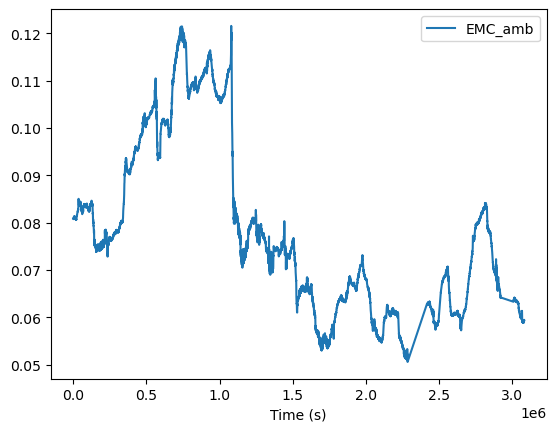

In [50]:
EMC_amb.plot (x="Time (s)",y = "EMC_amb")

In [52]:
# Create smoothed copy (same index + time)
EMC_amb_smooth = pd.DataFrame(index=EMC_amb.index)
EMC_amb_smooth[datetime_col_new] = EMC_amb[datetime_col_new]

In [61]:
# Create an empty DataFrame for smoothed results
EMC_amb_smooth = pd.DataFrame()
EMC_amb_smooth['Time (s)'] = EMC_amb['Time (s)']  # keep time

roll = 0  # 1 = rolling median, 0 = savgol

if roll == 1:
    # --- Rolling median ---
    window = 10  # window size in samples

    EMC_amb_smooth['EMC_amb'] = (
        EMC_amb['EMC_amb']
        .rolling(window=window, center=True, min_periods=1)
        .median()
    )

else:
    # --- Savitzky–Golay smoothing ---
    window_length = 1000   # must be odd and <= number of rows
    polyorder = 1

    n_rows = len(EMC_amb)
    if window_length > n_rows:
        window_length = n_rows if n_rows % 2 == 1 else n_rows - 1

    y = EMC_amb['EMC_amb'].to_numpy()

    # 1) smooth on the SAME grid
    y_smooth = savgol_filter(
        y,
        window_length=window_length,
        polyorder=polyorder
    )

    # 2) ensure starts at zero if needed:
    # y_smooth = y_smooth - y_smooth[0]

    EMC_amb_smooth['EMC_amb'] = y_smooth  # store result correctly


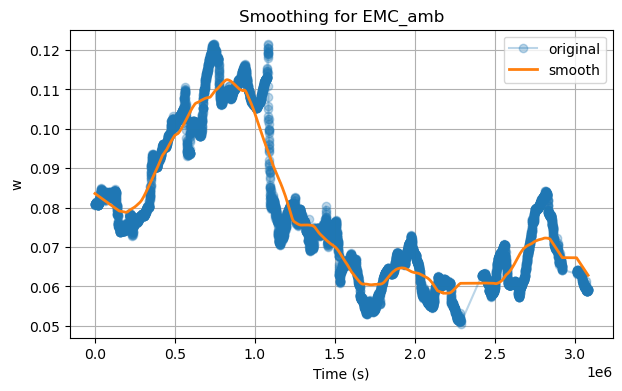

In [62]:
col_to_check = 'EMC_amb'  # pick any

plt.figure(figsize=(7, 4))
plt.plot(EMC_amb[datetime_col_new], EMC_amb[col_to_check],
         'o-', alpha=0.3, label='original')
plt.plot(EMC_amb_smooth[datetime_col_new], EMC_amb_smooth[col_to_check],
         '-', linewidth=2, label='smooth')
plt.xlabel(datetime_col_new)
plt.ylabel('w')
plt.legend()
plt.grid(True)
plt.title(f'Smoothing for {col_to_check}')
plt.show()

In [63]:
EMC_amb_smooth.to_csv ("EMC_amb_clt2D.csv",index=False)

In [10]:
w_delta = pd.DataFrame(index=w.index)
w_delta["Time (s)"] = w["Time (s)"]

# pick the r-columns that actually exist
rcols = [f"r{i}" for i in range(1, 50) if f"r{i}" in w.columns]

# baseline = values in the first row (by position)
baseline = w.loc[w.index[0], rcols]   # or: w[rcols].iloc[0]
# subtract column-wise (vectorized)
w_delta[rcols] = w[rcols].subtract(baseline, axis=1)

w_delta

,Time (s),r1,r2,r3,r4,r5,r6,r7,r8,r9,...,r40,r41,r42,r43,r44,r45,r46,r47,r48,r49
0,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1,300.0,0.000005,0.000000,0.000005,0.000000,-0.000051,0.000000,0.000005,0.000000,0.000000,...,0.000000,-0.000050,0.000005,0.000000,0.000000,0.000000,0.000000,0.000005,0.000000,0.000089
2,600.0,0.000011,0.000005,0.000011,0.000000,-0.000051,0.000005,0.000005,0.000005,-0.000097,...,0.000000,-0.000045,0.000000,0.000005,0.000000,0.000005,0.000000,0.000005,0.000005,-0.000022
3,901.0,0.000011,0.000011,0.000011,0.000005,-0.000051,0.000005,0.000005,0.000005,-0.000097,...,-0.000028,-0.000045,0.000005,0.000000,0.000000,-0.000061,0.000005,0.000005,0.000005,0.000099
4,1201.0,0.000011,0.000011,0.000011,0.000005,-0.000045,0.000005,0.000005,0.000005,-0.000091,...,-0.000028,-0.000039,0.000005,0.000005,0.000005,-0.000055,-0.000028,0.000005,0.000005,0.000156
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9530,3082075.0,0.024940,0.026352,-0.003201,-0.010093,-0.006289,-0.003956,-0.006094,-0.011254,-0.009863,...,0.008622,-0.007598,-0.001558,0.001819,0.000957,-0.010361,-0.005556,-0.001748,-0.001296,-0.021712
9531,3082375.0,0.024940,0.026415,-0.003131,-0.010093,-0.006257,-0.003956,-0.006094,-0.011254,-0.009853,...,0.008611,-0.007603,-0.001530,0.001808,0.000951,-0.010319,-0.005566,-0.001644,-0.001301,-0.021537
9532,3082675.0,0.024982,0.026484,-0.003082,-0.010041,-0.006240,-0.003902,-0.006040,-0.011207,-0.009848,...,0.008653,-0.007608,-0.001491,0.001803,0.000935,-0.010281,-0.005523,-0.001649,-0.001317,-0.021478
9533,3082975.0,0.024988,0.026484,-0.003028,-0.010041,-0.006235,-0.003902,-0.006035,-0.011207,-0.009848,...,0.008636,-0.007608,-0.001496,0.001848,0.000980,-0.010239,-0.005528,-0.001655,-0.001322,-0.021313


## Plot x,y mositure in time

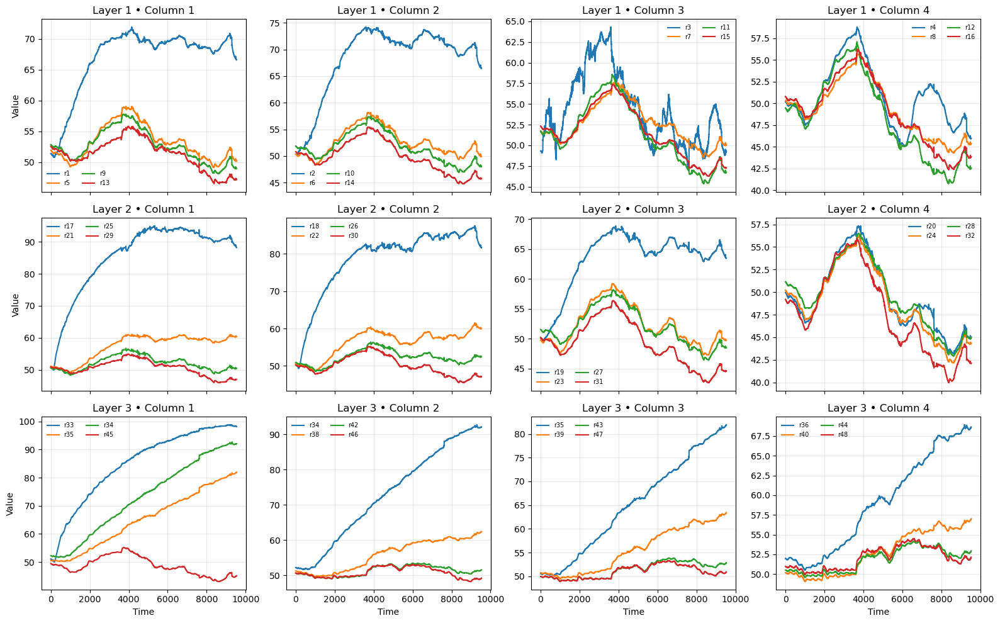

In [11]:
df = rh.copy ()

# Map (layer, column) -> list of its four sensor column names in df
groups = {
    (1, 1): ["r1", "r5", "r9", "r13"],
    (1, 2): ["r2", "r6", "r10", "r14"],
    (1, 3): ["r3", "r7", "r11", "r15"],
    (1, 4): ["r4", "r8", "r12", "r16"],
    (2, 1): ["r17", "r21", "r25", "r29"],
    (2, 2): ["r18", "r22", "r26", "r30"],
    (2, 3): ["r19", "r23", "r27", "r31"],
    (2, 4): ["r20", "r24", "r28", "r32"],
    (3, 1): ["r33", "r35", "r34", "r45"],
    (3, 2): ["r34", "r38", "r42", "r46"],
    (3, 3): ["r35", "r39", "r43", "r47"],
    (3, 4): ["r36", "r40", "r44", "r48"],
}

time_col = "Time (s)"  # or None to use index
x = df[time_col] if time_col and time_col in df.columns else df.index

num_layers, num_cols = 3, 4
fig, axes = plt.subplots(nrows=num_layers, ncols=num_cols, figsize=(16, 10), sharex=True)

for L in range(1, num_layers+1):
    for C in range(1, num_cols+1):
        ax = axes[L-1, C-1]
        for s in groups.get((L, C), []):
            ax.plot(x, df[s], label=s)
        ax.set_title(f"Layer {L} • Column {C}")
        ax.grid(True, alpha=0.3)
        if groups.get((L, C), []):
            ax.legend(fontsize="x-small", ncol=2, frameon=False)

for r in range(num_layers):
    axes[r, 0].set_ylabel("Value")
for c in range(num_cols):
    axes[-1, c].set_xlabel("Time")

plt.tight_layout()
plt.savefig ("all_sens_2D_rh.png")
plt.show()


## 3D plot and animation mositure in time

In [78]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import colormaps
from matplotlib.colors import Normalize
from mpl_toolkits.mplot3d import Axes3D  # noqa: F401
from matplotlib.animation import FuncAnimation, PillowWriter

def animate_sensors_3d(
    df,
    groups,
    time_col=None,              # e.g. "Time (s)" or None
    stride=1,
    point_size=30,
    add_stems=True,
    cmap_name="viridis",
    vmin=None, vmax=None,       # color scaling for points
    elev=25, azim=-135,
    fps=20,
    show_inline=True,
    save_gif=None,
    save_mp4=None,

    # --- NEW: axis fitting options ---
    xlim=(0.5, 4.5),            # columns 1..4 with jitter room
    ylim=(0.5, 3.5),            # layers 1..3 with jitter room
    zlim_mode="global",         # "global" | "follow"
    zpad_frac=0.05,             # padding added to z-limits (fraction of range)

    # --- NEW: save a still at a given time step ---
    save_frame_at=None,         # integer row index (e.g., 1 or -1) or None
    save_frame_path=None,       # e.g., "snapshot.png"
    save_frame_dpi=300
):
    """
    Animates 3D scatter: x=column, y=layer, z=value for all four sensors per (layer, column), over time.
    zlim_mode:
        - "global": z-limits fixed from all animated frames (prevents points from running off axes)
        - "follow": z-limits recomputed each frame to tightly fit data
    save_frame_at/save_frame_path:
        - If both are set, a high-res still of that time step is saved.
    """

    # --- 1) Build static XY positions (2x2 micro-grid inside each cell) ---
    micro = [(-0.15, -0.15), (-0.15, 0.15), (0.15, -0.15), (0.15, 0.15)]
    xs, ys, sensor_cols = [], [], []
    for (L, C), sensors in groups.items():
        for k, s in enumerate(sensors[:4]):
            if s not in df.columns:
                continue
            dx, dy = micro[k % 4]
            xs.append(C + dx)
            ys.append(L + dy)
            sensor_cols.append(s)

    xs = np.asarray(xs, dtype=float)
    ys = np.asarray(ys, dtype=float)

    # --- 2) Time indexing & color scaling ---
    idxs = np.arange(len(df))[::stride]
    cmap = colormaps.get_cmap(cmap_name)

    # Color scale based on animated frames
    if vmin is None or vmax is None:
        vals = df.iloc[idxs][sensor_cols].to_numpy(dtype=float)
        if vmin is None: vmin = np.nanmin(vals)
        if vmax is None: vmax = np.nanmax(vals)

    norm = Normalize(vmin=vmin, vmax=vmax, clip=True)

    # --- 3) Figure/axes ---
    fig = plt.figure(figsize=(10, 7))  # avoid constrained_layout=True to prevent warning
    ax = fig.add_subplot(111, projection="3d")
    ax.view_init(elev=elev, azim=azim)

    # Fixed X/Y limits (keeps all points visible horizontally)
    if xlim: ax.set_xlim(*xlim)
    if ylim: ax.set_ylim(*ylim)

    # Global Z limits (precomputed) if requested
    if zlim_mode == "global":
        zmin = np.nanmin(vals)
        zmax = np.nanmax(vals)
        zpad = (zmax - zmin + 1e-12) * zpad_frac
        ax.set_zlim(zmin - zpad, zmax + zpad)

    # Stems & scatter artists
    stem_lines = None
    if add_stems:
        stem_lines = [ax.plot([x, x], [y, y], [0, 0], linewidth=1)[0] for x, y in zip(xs, ys)]

    zs0 = np.zeros_like(xs)
    sc = ax.scatter(xs, ys, zs0, s=point_size, c=cmap(norm(zs0)))

    # Axes labels/ticks
    ax.set_xlabel("Column"); ax.set_xticks([1,2,3,4]); ax.set_xticklabels([f"C{c}" for c in [1,2,3,4]])
    ax.set_ylabel("Layer");  ax.set_yticks([1,2,3]);    ax.set_yticklabels([f"L{l}" for l in [1,2,3]])
    ax.set_zlabel("w")

    # Colorbar
    mappable = plt.cm.ScalarMappable(norm=norm, cmap=cmap)
    mappable.set_array([])
    cbar = fig.colorbar(mappable, ax=ax, shrink=0.78, aspect=16, pad=0.02)
    cbar.set_label("Value")

    def frame_title(irow):
        if time_col and (time_col in df.columns):
            return f"3D sensors • row {irow} (t={df.iloc[irow][time_col]})"
        return f"3D sensors • row {irow}"

    ax.set_title(frame_title(idxs[0]))

    # --- 4) Update function (optionally autoscale Z per frame) ---
    def update(frame_idx):
        i = idxs[frame_idx]
        zs = df.iloc[i][sensor_cols].to_numpy(dtype=float)

        sc._offsets3d = (xs, ys, zs)
        sc.set_color(cmap(norm(zs)))

        if stem_lines is not None:
            for line, x0, y0, z0 in zip(stem_lines, xs, ys, zs):
                line.set_data_3d([x0, x0], [y0, y0], [0, z0])

        if zlim_mode == "follow":
            zmin = np.nanmin(zs); zmax = np.nanmax(zs)
            zpad = (zmax - zmin + 1e-12) * zpad_frac
            ax.set_zlim(zmin - zpad, zmax + zpad)

        ax.set_title(frame_title(i))
        return (sc,) if stem_lines is None else (sc, *stem_lines)

    anim = FuncAnimation(fig, update, frames=len(idxs), interval=1000/fps, blit=False)

    # --- 5) Optional: save a still at a specific row index ---
    if (save_frame_at is not None) and (save_frame_path is not None):
        # Render that specific frame, then save
        try:
            # If save_frame_at isn't one of idxs, we still render it directly
            irow = save_frame_at
            zs = df.iloc[irow][sensor_cols].to_numpy(dtype=float)

            # Update artists once
            sc._offsets3d = (xs, ys, zs)
            sc.set_color(cmap(norm(zs)))
            if stem_lines is not None:
                for line, x0, y0, z0 in zip(stem_lines, xs, ys, zs):
                    line.set_data_3d([x0, x0], [y0, y0], [0, z0])

            if zlim_mode == "follow":
                zmin = np.nanmin(zs); zmax = np.nanmax(zs)
                zpad = (zmax - zmin + 1e-12) * zpad_frac
                ax.set_zlim(zmin - zpad, zmax + zpad)

            ax.set_title(frame_title(irow))
            fig.savefig(save_frame_path, dpi=save_frame_dpi, bbox_inches="tight")
            print(f"Saved still -> {save_frame_path}")
        except Exception as e:
            print("Saving still failed:", e)

    # --- 6) Optional: save animation ---
    if save_gif:
        try:
            anim.save(save_gif, writer=PillowWriter(fps=fps))
            print(f"Saved GIF -> {save_gif}")
        except Exception as e:
            print("GIF save failed:", e)

    if save_mp4:
        try:
            anim.save(save_mp4, writer="ffmpeg", fps=fps)
            print(f"Saved MP4 -> {save_mp4}")
        except Exception as e:
            print("MP4 save failed (needs ffmpeg):", e)

    if show_inline:
        from IPython.display import HTML, display
        display(HTML(anim.to_jshtml()))

    return anim, fig, ax


Saved still -> snapshot_row_last.png
Saved GIF -> sensors.gif


Animation size has reached 21033570 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


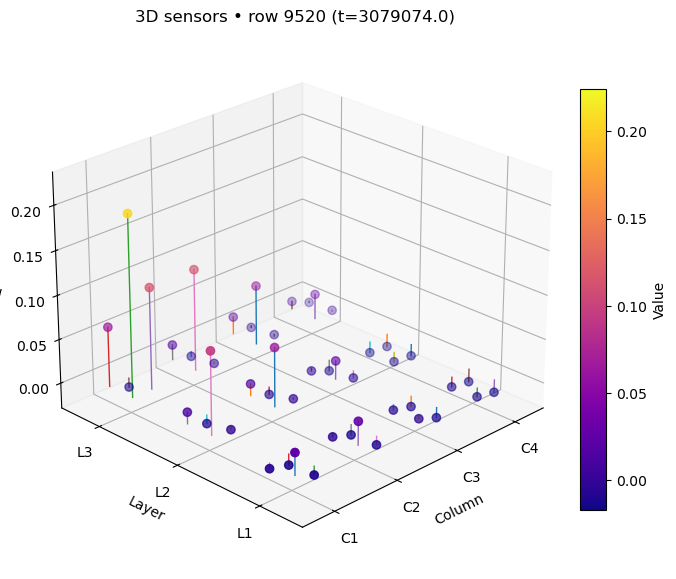

In [79]:
groups = {
    (1, 1): ["r1", "r5", "r9", "r13"],
    (1, 2): ["r2", "r6", "r10", "r14"],
    (1, 3): ["r3", "r7", "r11", "r15"],
    (1, 4): ["r4", "r8", "r12", "r16"],
    (2, 1): ["r17", "r21", "r25", "r29"],
    (2, 2): ["r18", "r22", "r26", "r30"],
    (2, 3): ["r19", "r23", "r27", "r31"],
    (2, 4): ["r20", "r24", "r28", "r32"],
    (3, 1): ["r33", "r35", "r34", "r45"],
    (3, 2): ["r34", "r38", "r42", "r46"],
    (3, 3): ["r35", "r39", "r43", "r47"],
    (3, 4): ["r36", "r40", "r44", "r48"],
}

# Example call
anim, fig, ax = animate_sensors_3d(
    df=w_delta,                 # your DataFrame
    groups=groups,
    time_col="Time (s)",        # or None
    stride=20,                   # increase to 2/5/10 if large data
    fps=200,
    zlim_mode="global",
    point_size=36,
    add_stems=True,
    cmap_name="plasma",
    save_gif= "sensors.gif",              # set "sensors.gif" to export
    save_mp4=None,              # set "sensors.mp4" to export (requires ffmpeg)
    #show_inline=True
    save_frame_at=-1,                 # e.g., second row
    save_frame_path="snapshot_row_last.png",
    save_frame_dpi=300
)


## Mass

In [12]:
df_m = pd.read_excel("clt2d_hmotnosti_upraveno.xlsx", sheet_name = None)
df_m = df_m.copy()
# check sheet names
for sheet_name, names in df_m.items():
    print(f"Sheet name: {sheet_name}")
    print(names.head())  # or print(df) if you want the full table
    print("-" * 40)

m = df_m['uptake']

Sheet name: uptake
                  cas         m
0 2025-10-01 08:00:31  0.807600
1 2025-10-01 08:01:31  0.807737
2 2025-10-01 08:02:31  0.807873
3 2025-10-01 08:03:31  0.808010
4 2025-10-01 08:04:31  0.808147
----------------------------------------
Sheet name: drying
                  cas      m
0 2025-11-05 00:48:13  1.363
1 2025-11-05 00:49:13  1.363
2 2025-11-05 00:50:13  1.363
3 2025-11-05 00:51:13  1.363
4 2025-11-05 00:52:13  1.359
----------------------------------------


In [13]:
# Subtract datetime separately
datetime_col = "cas"
datetime_col_new = 'Time (s)'
m[datetime_col_new] = m[datetime_col] - m.iloc[0][datetime_col]
## Date to minutes and seconds
m[datetime_col_new] = m[datetime_col_new].dt.total_seconds()

m

,cas,m,Time (s)
0,2025-10-01 08:00:31,0.807600,0.0
1,2025-10-01 08:01:31,0.807737,60.0
2,2025-10-01 08:02:31,0.807873,120.0
3,2025-10-01 08:03:31,0.808010,180.0
4,2025-10-01 08:04:31,0.808147,240.0
...,...,...,...
17022,2025-10-13 03:45:05,1.403170,1021474.0
17023,2025-10-13 03:46:05,1.403170,1021534.0
17024,2025-10-13 03:47:05,1.403170,1021594.0
17025,2025-10-13 03:48:05,1.403170,1021654.0


In [65]:
#density average
dens = m['m'].iloc[0]/(0.9*0.9*0.1)
dens

9.970370370370368

In [71]:
#panel masss
m_clt = 479*(0.9*0.9*0.1)
m_clt

38.79900000000001

In [72]:
w_mass = m.copy()
w_mass ['m_delta'] = w_mass ['m'].sub(w_mass['m'].iloc[0])
w_mass['w'] = w_mass['m_delta'].div(m_clt)
w_mass

,cas,m,Time (s),m_delta,w
0,2025-10-01 08:00:31,0.807600,0.0,0.000000,0.000000
1,2025-10-01 08:01:31,0.807737,60.0,0.000137,0.000004
2,2025-10-01 08:02:31,0.807873,120.0,0.000273,0.000007
3,2025-10-01 08:03:31,0.808010,180.0,0.000410,0.000011
4,2025-10-01 08:04:31,0.808147,240.0,0.000547,0.000014
...,...,...,...,...,...
17022,2025-10-13 03:45:05,1.403170,1021474.0,0.595570,0.015350
17023,2025-10-13 03:46:05,1.403170,1021534.0,0.595570,0.015350
17024,2025-10-13 03:47:05,1.403170,1021594.0,0.595570,0.015350
17025,2025-10-13 03:48:05,1.403170,1021654.0,0.595570,0.015350


In [ ]:
m.to_csv ('.csv',index=False)

<Axes: xlabel='Time (s)'>

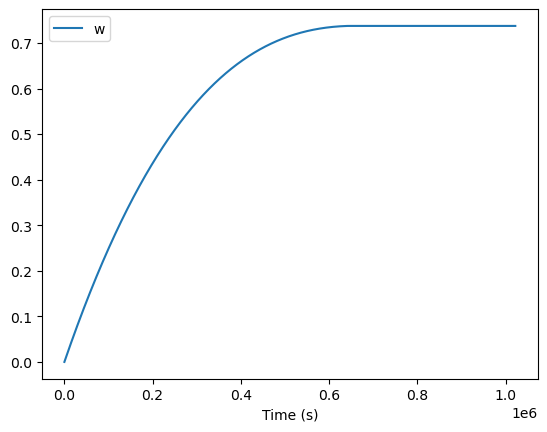

In [23]:
w_mass.plot (x="Time (s)",y = "w")

## COMSOL validation

In [81]:
# Read the text file
df_clt_valid = pd.read_csv(
    "clt2d.txt",     # path of the uploaded file
    sep=r"\s+",             # split by ANY whitespace
    skiprows=5,             # skip COMSOL header metadata
    header = None
    #names=["Time (s)", "c_b (1)", "c_b_first (1)"]  # rename columns
)
df_clt_valid

clt_cm = pd.DataFrame ()

# --- OPEN ---
clt_cm['Time (s)'] = df_clt_valid.iloc[:, 0].copy()
clt_cm['w (-)'] = df_clt_valid.iloc[:, 1].copy()
clt_cm['w_rel (-)'] = df_clt_valid.iloc[:, 2].copy()

clt_cm

,Time (s),w (-),w_rel (-)
0,0,0.100393,0.000000
1,10217,0.101024,0.000631
2,20434,0.101539,0.001146
3,30651,0.102040,0.001647
4,40868,0.102494,0.002101
...,...,...,...
96,980832,0.117474,0.017081
97,991049,0.117464,0.017071
98,1001266,0.117446,0.017054
99,1011483,0.117423,0.017030


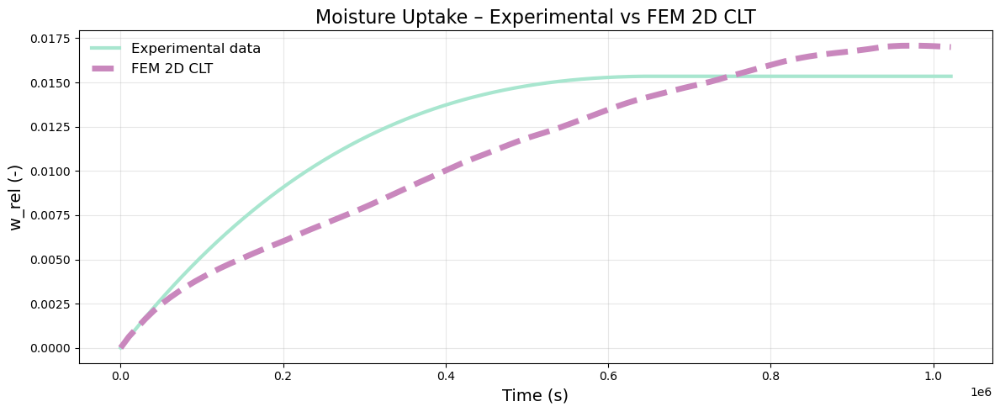

In [89]:
# Colors
mint_light      = '#A8E6CF'   # light mint for original (soft green)
blue_line       = '#1f77b4'   # blue for exponential fit (not used here yet)
pink_line_fem_o = '#C987BD'   # FEM (COMSOL) curves

# Create figure
fig, ax = plt.subplots(figsize=(12, 5))

# --- EXPERIMENTAL DATA ---
ax.plot(
    w_mass['Time (s)'],
    w_mass['w'],
    linestyle='-',
    color=mint_light,
    alpha=1,
    label='Experimental data',
    linewidth=3
)

# --- FEM / COMSOL DATA ---
ax.plot(
    clt_cm['Time (s)'],
    clt_cm['w_rel (-)'],
    linestyle='--',
    color=pink_line_fem_o,
    alpha=1,
    label='FEM 2D CLT',
    linewidth=5
)

# --- TITLE, LABELS, GRID ---
ax.set_title("Moisture Uptake – Experimental vs FEM 2D CLT", fontsize=16)
ax.set_xlabel("Time (s)", fontsize=14)
ax.set_ylabel("w_rel (-)", fontsize=14)

ax.legend(frameon=False, fontsize=12)
ax.grid(True, alpha=0.3)

plt.tight_layout()
plt.show()


fig.savefig('clt2d_valid.png', dpi=300, bbox_inches="tight")

In [77]:
w_mass_exp = pd.DataFrame ()
w_mass_exp['time'] =  w_mass['Time (s)']
w_mass_exp['w'] =  w_mass['w']
w_mass_exp.to_csv ("wmass_clt2D.csv",index=False)
w_mass_exp

,time,w
0,0.0,0.000000
1,60.0,0.000004
2,120.0,0.000007
3,180.0,0.000011
4,240.0,0.000014
...,...,...
17022,1021474.0,0.015350
17023,1021534.0,0.015350
17024,1021594.0,0.015350
17025,1021654.0,0.015350
